In [1]:
import glob
import numpy as np
import matplotlib.pyplot as plt
from astropy.table import Table
import matplotlib.font_manager as font_manager
from matplotlib.ticker import (MultipleLocator, FormatStrFormatter,
                               AutoMinorLocator)
font_prop = font_manager.FontProperties(size=18)
plt.rcParams["font.family"] = "Times"
%matplotlib inline

files = glob.glob("./PA/test_*.fits")

In [2]:
len(files)

361

In [3]:
files

['./PA/test_37.0_150.0_2.2.fits',
 './PA/test_125.0_150.0_2.2.fits',
 './PA/test_84.5_150.0_2.2.fits',
 './PA/test_170.5_150.0_2.2.fits',
 './PA/test_2.5_150.0_2.2.fits',
 './PA/test_62.5_150.0_2.2.fits',
 './PA/test_115.5_150.0_2.2.fits',
 './PA/test_39.5_150.0_2.2.fits',
 './PA/test_52.0_150.0_2.2.fits',
 './PA/test_140.0_150.0_2.2.fits',
 './PA/test_73.0_150.0_2.2.fits',
 './PA/test_95.0_150.0_2.2.fits',
 './PA/test_161.0_150.0_2.2.fits',
 './PA/test_134.5_150.0_2.2.fits',
 './PA/test_26.5_150.0_2.2.fits',
 './PA/test_18.5_150.0_2.2.fits',
 './PA/test_151.5_150.0_2.2.fits',
 './PA/test_43.5_150.0_2.2.fits',
 './PA/test_16.0_150.0_2.2.fits',
 './PA/test_28.0_150.0_2.2.fits',
 './PA/test_104.0_150.0_2.2.fits',
 './PA/test_32.5_150.0_2.2.fits',
 './PA/test_120.5_150.0_2.2.fits',
 './PA/test_7.0_150.0_2.2.fits',
 './PA/test_175.0_150.0_2.2.fits',
 './PA/test_81.0_150.0_2.2.fits',
 './PA/test_59.0_150.0_2.2.fits',
 './PA/test_67.0_150.0_2.2.fits',
 './PA/test_110.0_150.0_2.2.fits',
 './P

In [4]:
files[0].split("_")[1]#.split(".fits")[0]

'37.0'

In [5]:
science = []
calib = []
known_spec = []
core = []
angle = []
for i in files:
    data2 = Table.read(i, hdu = 2, format='fits')
    data1 = Table.read(i, hdu = 1, format='fits')
    angle.append(float(i.split("_")[1]))
    #masking for assignment allocation
    assigned_SCIENCEfibers = ((data2['assigned'] == 1) & (data1['category'] == 'science'))
    assigned_CALIBfibers = ((data2['assigned'] == 1) & ((data1['category'] == 'sky_boss') | (data1['category'] == 'standard_boss')))


    #Carton breakdown
    assigned_known = ((data2['assigned'] == 1) & (data1['carton'] == 'bhm_rm_known_spec'))
    assigned_core = ((data2['assigned'] == 1) & (data1['carton'] == 'bhm_rm_core'))
    #assigned_var = ((data2['assigned'] == 1) & (data1['carton'] == 'bhm_rm_var'))
    #assigned_ancil = ((data2['assigned'] == 1) & (data1['carton'] == 'bhm_rm_ancillary'))
    
    science.append(len(data1[assigned_SCIENCEfibers]))
    calib.append(len(data1[assigned_CALIBfibers]))
    known_spec.append(len(data1[assigned_known]))
    core.append(len(data1[assigned_core]))
science = np.array(science)
calib = np.array(calib)
known_spec = np.array(known_spec)
angle = np.array(angle)
core = np.array(core)

In [6]:
angle[np.argmin(known_spec)]

138.5

In [7]:
mask = (calib < 120.)
print("known", known_spec[mask])
print("angle", angle[mask])

known []
angle []


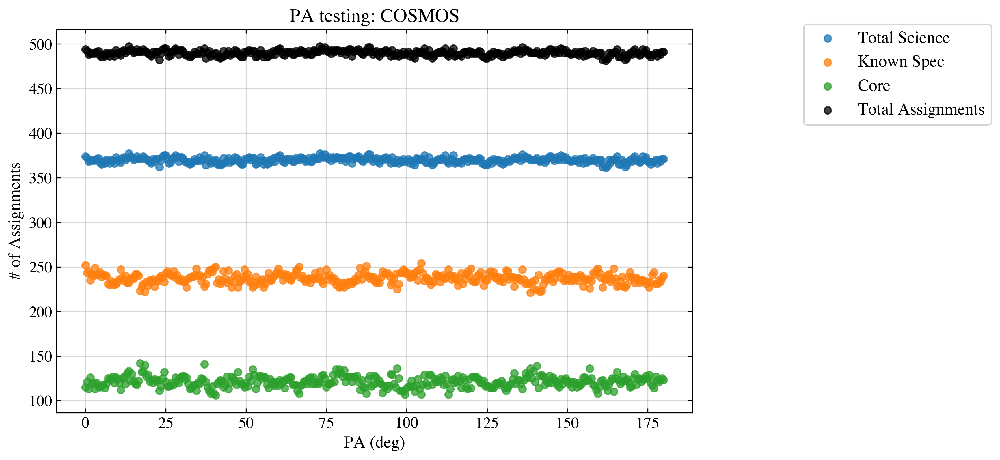

In [8]:
size = 14

#fig
fig, ax = plt.subplots(figsize=(8, 5), dpi=300, facecolor='white')
fig.tight_layout()
#field center lines
#ax.axhline(y=325, linestyle='--', color='black', alpha=0.2, zorder=0)
#plot
ax.scatter(angle, science, alpha=0.75,label="Total Science")
ax.scatter(angle, known_spec, alpha=0.75,label="Known Spec")
ax.scatter(angle, core, alpha=0.75,label="Core" )
ax.scatter(angle, science+calib, color='black', alpha=0.75,label="Total Assignments" )


#labels, etc
ax.set_xlabel("PA (deg)", fontsize=size)
ax.set_ylabel("# of Assignments", fontsize=size)
ax.set_title("PA testing: COSMOS", fontsize=size+2)
ax.tick_params(axis='both', which='major', labelsize=size-1, 
               top=True, right=True, bottom=True, left=True, direction='in')
ax.tick_params(axis='both', which='minor', labelsize=size-1, 
               top=True, right=True, bottom=True, left=True, direction='in')
plt.grid(alpha=0.5)
ax.set_axisbelow(True) 
plt.legend(loc=(1.175, 0.75), prop={"size":size})

# inset_ax = fig.add_axes([1.05, 0.2, 0.4, 0.4]) 

# inset_ax.scatter(angle, science, alpha=0.75,label="Total Science")
# inset_ax.scatter(angle, known_spec, alpha=0.75,label="Known Spec")

# inset_ax.set_title(r'Zoom around 23$^\circ$', fontsize=size)
# inset_ax.axhline(y=325, linestyle='--', color='black', alpha=0.2, zorder=0)
# # set axis range
# inset_ax.set_xlim(22.5, 23.5)
# plt.grid(alpha=0.25)
# #inset_ax.set_ylim(-.005, .01)
# inset_ax.tick_params(axis='both', which='major', labelsize=size-1, 
#                top=True, right=True, bottom=True, left=True, direction='in')
# inset_ax.tick_params(axis='both', which='minor', labelsize=size-1, 
#                top=True, right=True, bottom=True, left=True, direction='in')
# # set axis tick locations
# inset_ax.set_yticks([300, 320, 340, 360])
# #inset_ax.set_xticks([-0.1,0,.1]);



#plt.savefig("PA_COSMOS.png", facecolor=fig.get_facecolor(), bbox_inches='tight',dpi=300)

In [25]:
tot = science + calib
known_spec[np.where(tot >= 495)]

array([228, 245, 238, 232, 234, 240, 234, 240, 237, 233, 240, 243, 243,
       238, 247, 237])

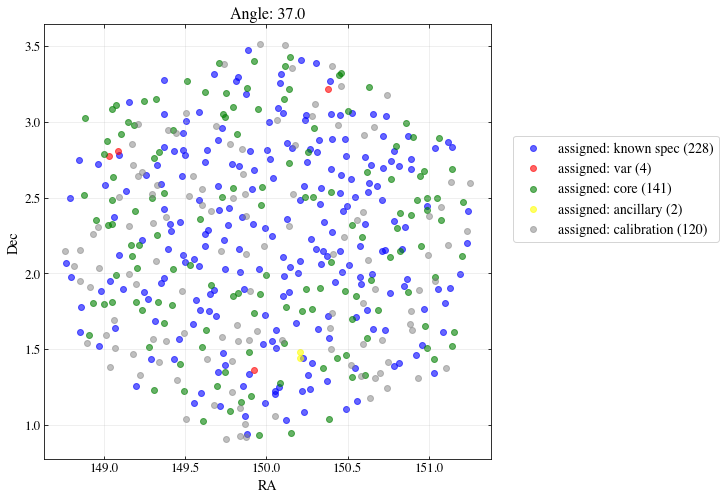

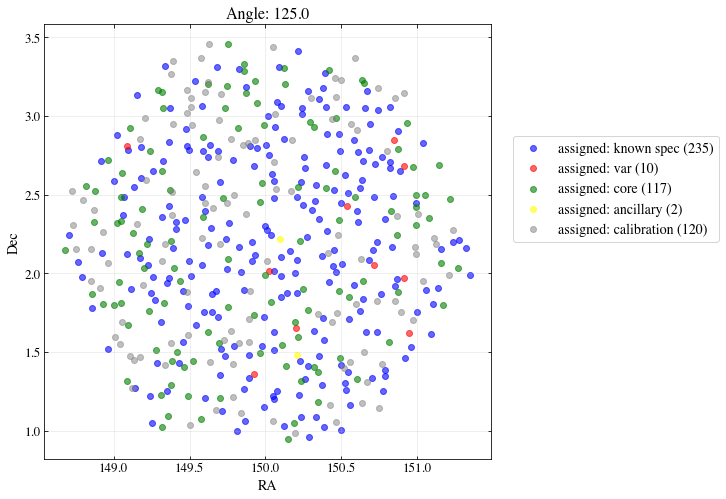

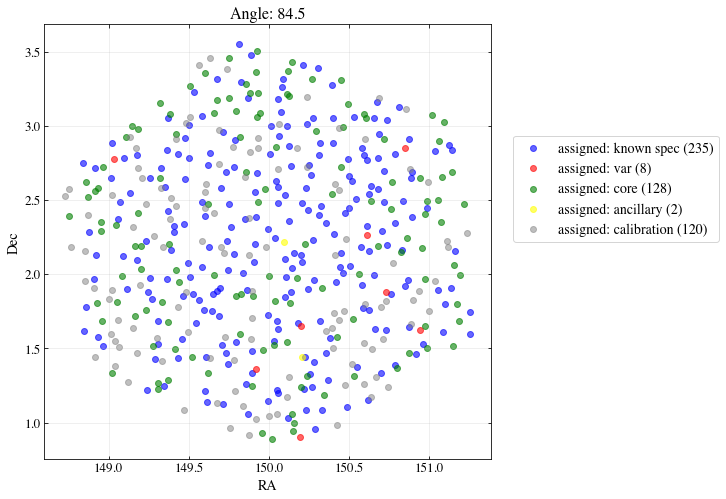

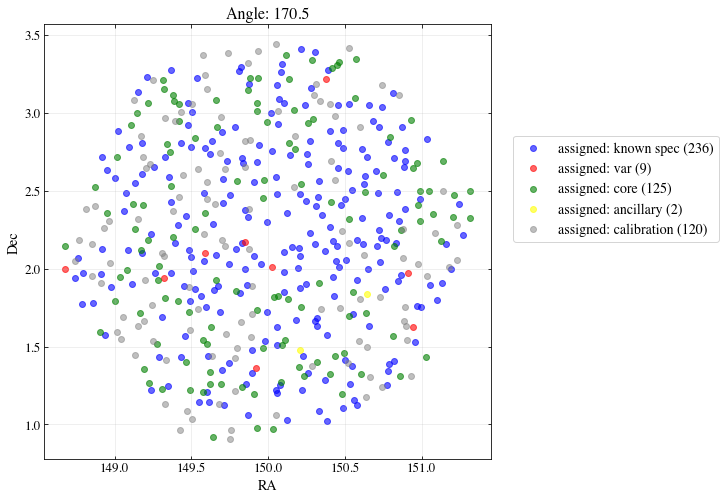

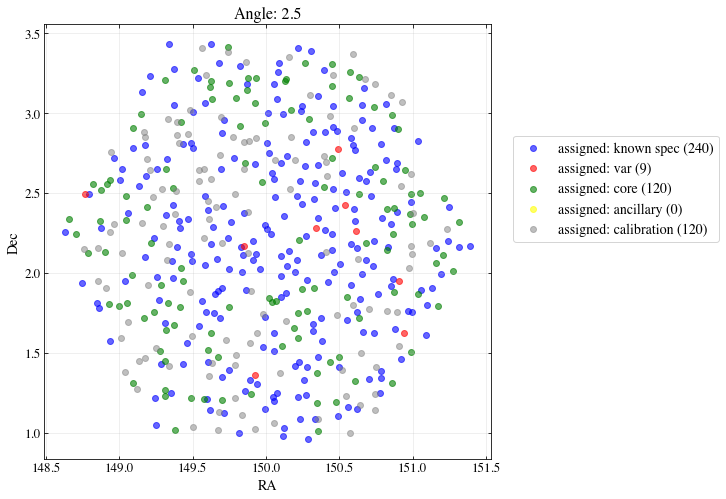

...

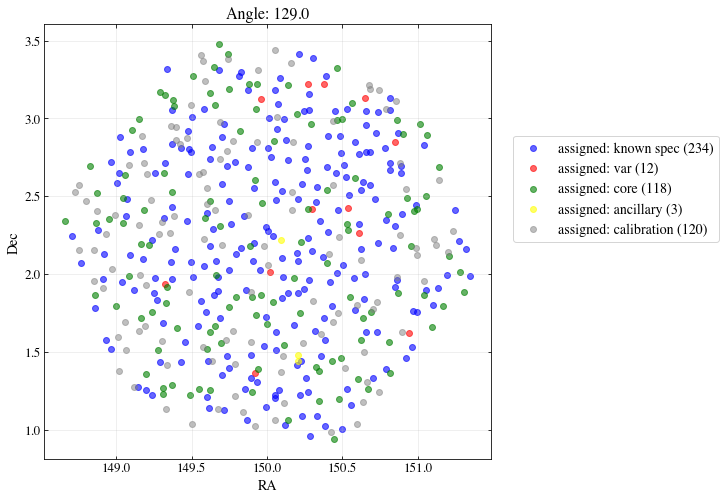

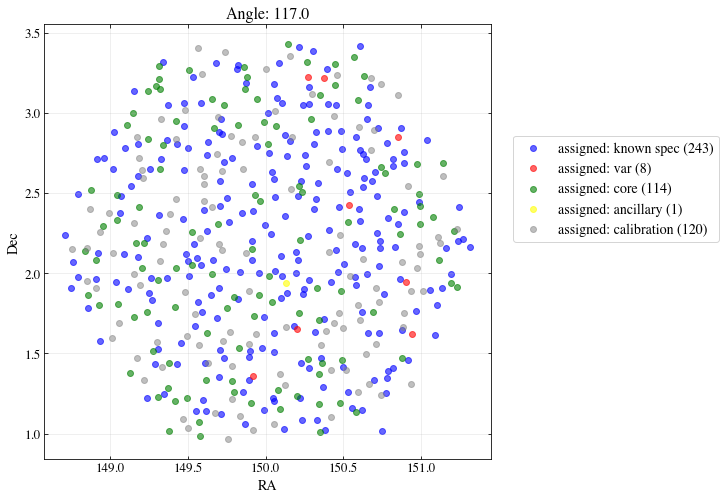

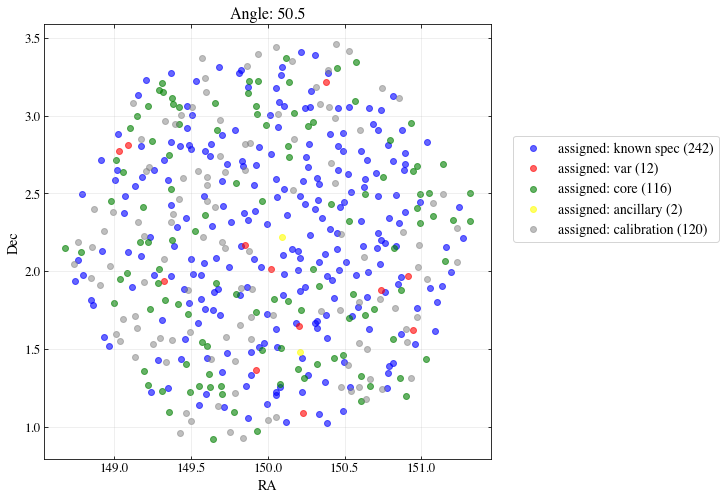

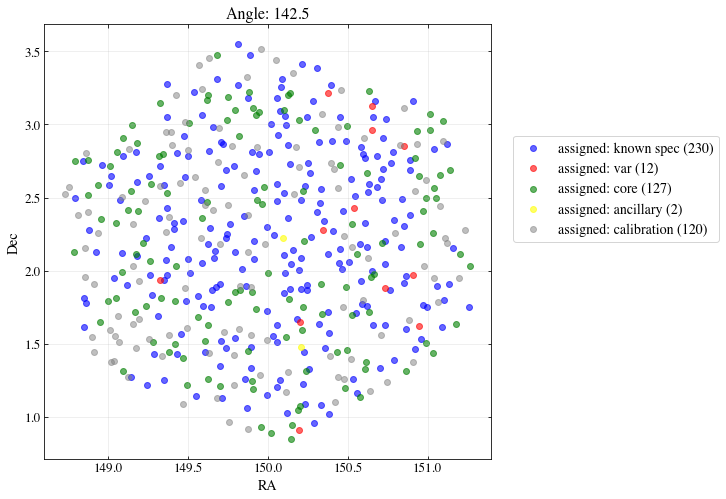

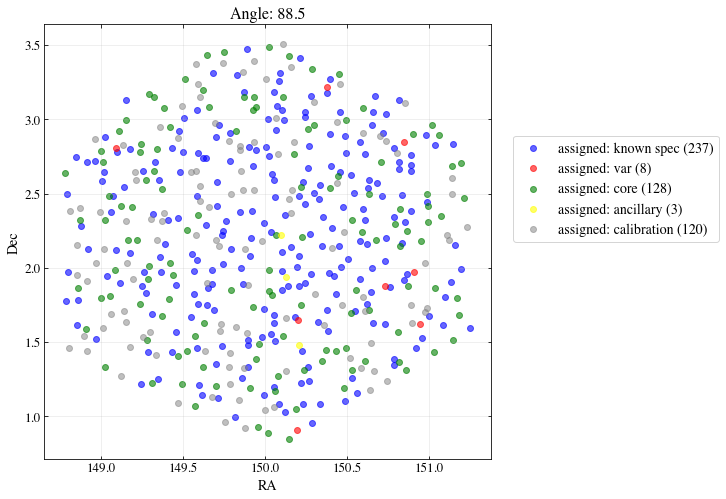

In [26]:
for i in files:
    data2 = Table.read(i, hdu = 2, format='fits')
    data1 = Table.read(i, hdu = 1, format='fits')
    angle = float(i.split("_")[1])

    assigned_SCIENCEfibers = ((data2['assigned'] == 1) & (data1['category'] == 'science'))
    assigned_CALIBfibers = ((data2['assigned'] == 1) & ((data1['category'] == 'sky_boss') | (data1['category'] == 'standard_boss')))


    #Carton breakdown
    assigned_known = ((data2['assigned'] == 1) & (data1['carton'] == 'bhm_rm_known_spec'))
    assigned_core = ((data2['assigned'] == 1) & (data1['carton'] == 'bhm_rm_core'))
    assigned_var = ((data2['assigned'] == 1) & (data1['carton'] == 'bhm_rm_var'))
    assigned_ancil = ((data2['assigned'] == 1) & (data1['carton'] == 'bhm_rm_ancillary'))
    #plt.figure(figsize=(10,10))
    fig, axs = plt.subplots(1, 1, figsize=(8, 8))
    axs.grid(alpha=0.25, zorder=0)
    axs.scatter(data1["ra"][assigned_known], data1["dec"][assigned_known],
                color = "blue", alpha = 0.6, 
                label="assigned: known spec ({})".format(len(data1["ra"][assigned_known])))
    axs.scatter(data1["ra"][assigned_var], data1["dec"][assigned_var],
                color = "red", alpha = 0.6, 
                label="assigned: var ({})".format(len(data1["ra"][assigned_var])))
    axs.scatter(data1["ra"][assigned_core], data1["dec"][assigned_core],
                color = "green", alpha = 0.6, 
                label="assigned: core ({})".format(len(data1["ra"][assigned_core])))
    axs.scatter(data1["ra"][assigned_ancil], data1["dec"][assigned_ancil],
                color = "yellow", alpha = 0.6, 
                label="assigned: ancillary ({})".format(len(data1["ra"][assigned_ancil])))
    axs.scatter(data1["ra"][assigned_CALIBfibers], data1["dec"][assigned_CALIBfibers],
                color = "gray", alpha = 0.5, 
                label="assigned: calibration ({})".format(len(data1["ra"][assigned_CALIBfibers])))
    axs.legend(loc=(1.05,0.5), prop={"size":size})
    axs.set_xlabel('RA', fontsize=size)
    axs.set_ylabel('Dec', fontsize=size)
    axs.set_title("Angle: {}".format(angle), fontsize=size+2)
    axs.tick_params(axis='both', which='major', labelsize=size-1, 
                   top=True, right=True, bottom=True, left=True, direction='in')
    axs.tick_params(axis='both', which='minor', labelsize=size-1, 
                   top=True, right=True, bottom=True, left=True, direction='in')
    #axs.set_ylim(-6.5, -3.5)
    #axs.set_xlim(34.25, 37.25)

    plt.savefig("./PA/img_{}.png".format(angle), bbox_inches ='tight',dpi=300)

    plt.show()

In [42]:
# import glob
# from PIL import Image

# ##filepaths
# fp_in = "./img_*.png"
# fp_out = "./designs.gif"

# # # https://pillow.readthedocs.io/en/stable/handbook/image-file-formats.html#gif
# img, *imgs = [Image.open(f) for f in sorted(glob.glob(fp_in))]
# img.save(fp=fp_out, format='GIF', append_images=imgs,
#           save_all=True, duration=200, loop=0)



TypeError: 'NoneType' object is not iterable

# Are there common robots that are not assigned?

In [19]:
not_assigned = []
for i in files:
    data2 = Table.read(i, hdu = 2, format='fits')
    data1 = Table.read(i, hdu = 1, format='fits')
    robots = np.arange(1,501,1)
    assigned_robots = data2['robotID'][np.where(data2['robotID'] != -1)[0]]
    not_assigned.extend(list(np.setdiff1d(robots, assigned_robots)))

In [20]:
not_assigned = np.array(not_assigned)

In [21]:
len(not_assigned)

3687

In [22]:
from collections import Counter
c = Counter(not_assigned)
len(files)

361

In [23]:
c.most_common(20)

[(496, 60),
 (481, 58),
 (498, 40),
 (236, 39),
 (479, 38),
 (330, 37),
 (340, 35),
 (139, 35),
 (101, 35),
 (144, 33),
 (429, 32),
 (39, 32),
 (89, 31),
 (349, 31),
 (259, 29),
 (323, 29),
 (78, 29),
 (127, 28),
 (196, 28),
 (38, 27)]

In [1]:
57/305

0.18688524590163935

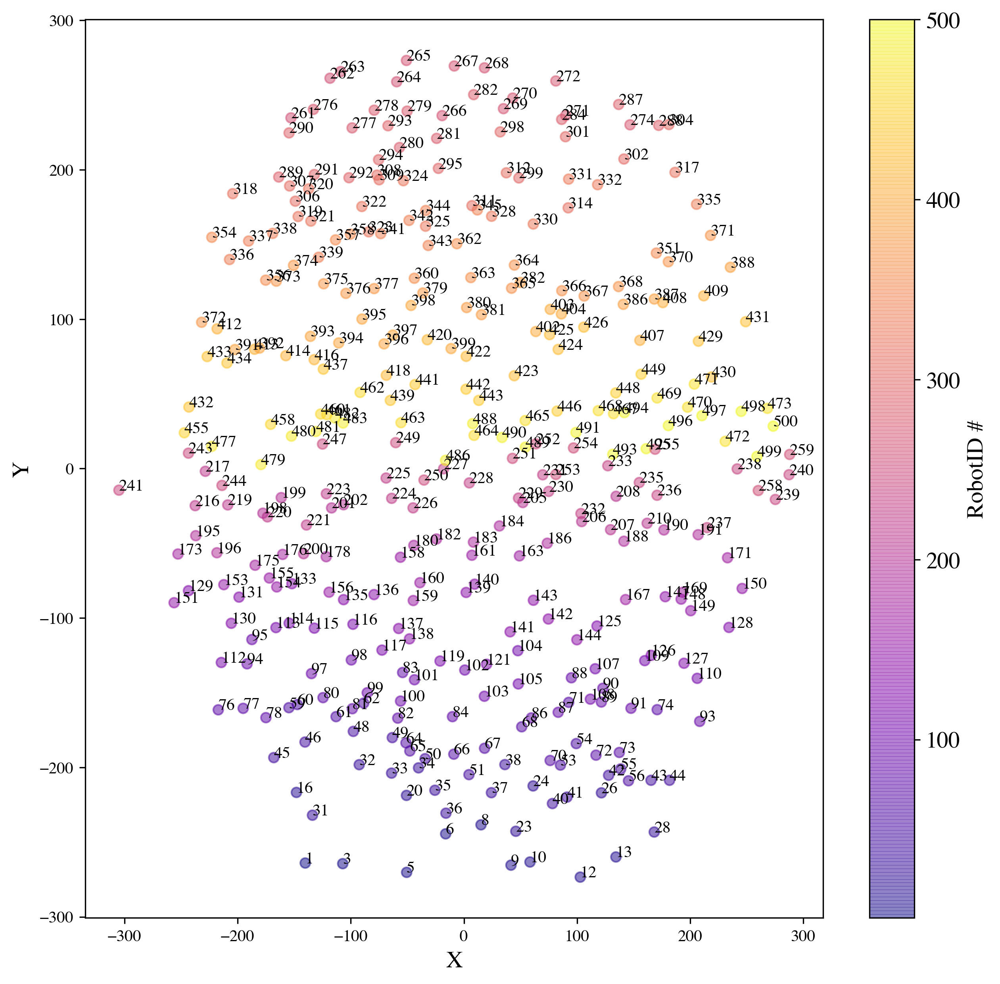

In [79]:
size=14
## now where are these fibers/robots
data2 = Table.read(files[3], hdu = 2, format='fits')
data1 = Table.read(files[3], hdu = 1, format='fits')
#angle = float(i.split("_")[1].split(".fits")[0])

assigned_SCIENCEfibers = ((data2['assigned'] == 1) & (data1['category'] == 'science'))
assigned_CALIBfibers = ((data2['assigned'] == 1) & ((data1['category'] == 'sky_boss') | (data1['category'] == 'standard_boss')))


#Carton breakdown
assigned_known = ((data2['assigned'] == 1) & (data1['carton'] == 'bhm_rm_known_spec'))

cols = data2['robotID'][assigned_SCIENCEfibers][:,1]
size = 14

#fig
fig, ax = plt.subplots(figsize=(10, 10), dpi=300, facecolor='white')

#plot
ec = ax.scatter(data1['x'][assigned_SCIENCEfibers], data1['y'][assigned_SCIENCEfibers], 
                alpha=0.5, c=cols,cmap='plasma')
ax.set_xlabel('X', fontsize=size)
ax.set_ylabel('Y', fontsize=size)

for i, txt in enumerate(data2['robotID'][assigned_SCIENCEfibers][:,1]):
    ax.annotate(txt, (data1['x'][assigned_SCIENCEfibers][i],  data1['y'][assigned_SCIENCEfibers][i]))
#colorbar stuff
cbar = plt.colorbar(ec)
cbar.set_label('RobotID #', fontsize=size)
cbar.ax.tick_params(labelsize=size)
#plt.savefig("robotID_layout2.png".format(angle), bbox_inches ='tight',dpi=300)

In [66]:
data2["robotID"][assigned_SCIENCEfibers][0]

array([498, 498, 498, ..., 498, 498, 498], dtype=int32)